<a href="https://colab.research.google.com/github/agarciam0879/Talento_Tech/blob/main/Notebook_Profile_Proyecto.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Hacer Profile de las Bases de Datos a Usar en el Proyecto

# Paso 1: Conectar al drive, instalar e importar las librerías

In [17]:
# Conectar al Drive

from google.colab import drive # Traemos la clase drive, dentro del módulo colab, del paquete google
drive.mount('/content/drive') # Establecemos la conexión através del método mount

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [18]:
# Instalar las librerías.

!pip install pydantic-settings
!pip install pandas-profiling
!pip install ydata-profiling

In [19]:
# Importar librerías
import pandas as pd
from datetime import datetime
from ydata_profiling import ProfileReport

# Paso 2: Conectar a las Bases de Datos

In [20]:
# Conectar a la base de datos de las empresas registradas en las Cámaras de Comercio de Colombia con corte abril de 2.024.
# https://www.datos.gov.co/Comercio-Industria-y-Turismo/Personas-Naturales-Personas-Jur-dicas-y-Entidades-/c82u-588k/data_preview
# Se usa la conexión por API en Json. La base de datos tiene 8.520.526 filas, por capacidad se hace muestra de 1.000.000 de filas.
df_Empresas = pd.read_json('https://www.datos.gov.co/resource/c82u-588k.json?$limit=1000000')
display(df_Empresas.head())

,codigo_camara,camara_comercio,matricula,inscripcion_proponente,razon_social,codigo_clase_identificacion,clase_identificacion,numero_identificacion,cod_ciiu_act_econ_pri,fecha_matricula,...,ciiu3,ciiu4,sigla,clase_identificacion_rl,num_identificacion_representante_legal,representante_legal,primer_nombre,primer_apellido,segundo_apellido,segundo_nombre
0,1,ARMENIA,9249,0.0,RAMIREZ DE OSPINA MARIA,1,CEDULA DE CIUDADANIA,24560913,9999,19740819.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,ARMENIA,9251,0.0,LONDONO GALLEGO DANILO,1,CEDULA DE CIUDADANIA,1265820,9999,19740819.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,ARMENIA,9253,0.0,ARTEAGA RAMIREZ PEDRO NEL,6,SIN IDENTIFICACION,53,9999,19740819.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,ARMENIA,9255,0.0,ZAPATA ARRUBLA EDUARDO,1,CEDULA DE CIUDADANIA,1315055,9999,19740819.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,ARMENIA,9257,0.0,MENDEZ MENDEZ PEDRO PABLO,1,CEDULA DE CIUDADANIA,1269522,9999,19740819.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [21]:
# Listar las columnas de la base de datos en una tabla.
Nombre_Columnas_df = pd.DataFrame(df_Empresas.columns, columns=['Nombre Columnas'])
styled_df = Nombre_Columnas_df.style.set_properties(**{'text-align': 'center'}) \
                                 .set_table_styles([dict(selector="th",props=[('text-align', 'center')])])
styled_df

,Nombre Columnas
0,codigo_camara
1,camara_comercio
2,matricula
3,inscripcion_proponente
4,razon_social
5,codigo_clase_identificacion
6,clase_identificacion
7,numero_identificacion
8,cod_ciiu_act_econ_pri
9,fecha_matricula


In [22]:
# prompt: crea una consulta de las Razones Sociales por Cámara de Comercio

consulta_camara = df_Empresas[['razon_social', 'camara_comercio']]
display(consulta_camara)


,razon_social,camara_comercio
0,RAMIREZ DE OSPINA MARIA,ARMENIA
1,LONDONO GALLEGO DANILO,ARMENIA
2,ARTEAGA RAMIREZ PEDRO NEL,ARMENIA
3,ZAPATA ARRUBLA EDUARDO,ARMENIA
4,MENDEZ MENDEZ PEDRO PABLO,ARMENIA
...,...,...
999995,MARLENNY MANIOS VERA,BOGOTA
999996,CASTILLO OSORIO LUIS FERNANDO,ABURRA SUR
999997,JOSE WILSON HERNANDEZ TREJOS,DOSQUEBRADAS
999998,SIMANCA MARTINEZ LEIBYS,BARRANQUILLA


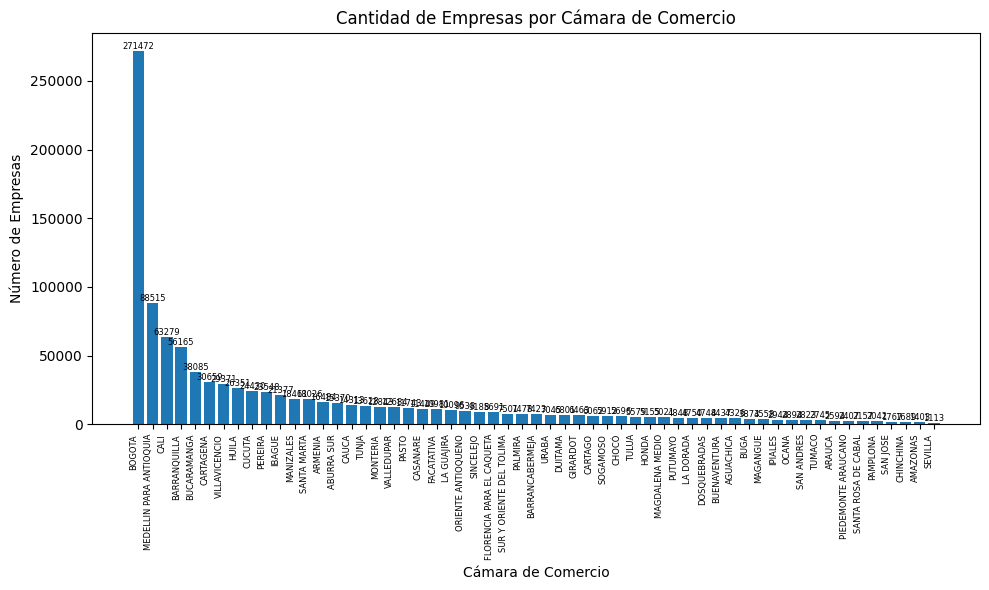

In [23]:
# prompt: Cuenta la cantidad de Empresas por Cámara de Comercio y grafica de mayor a menor con etiquetas de valor

import matplotlib.pyplot as plt

# Cuenta la cantidad de Empresas por Cámara de Comercio
Empresas_por_Camara = consulta_camara.groupby('camara_comercio')['razon_social'].count().sort_values(ascending=False)

# Crea el gráfico de barras
plt.figure(figsize=(10, 6))
bars = plt.bar(Empresas_por_Camara.index, Empresas_por_Camara.values)

# Agrega etiquetas de valor a cada barra
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center', fontsize=6)

plt.xlabel('Cámara de Comercio')
plt.ylabel('Número de Empresas')
plt.title('Cantidad de Empresas por Cámara de Comercio')
plt.xticks(rotation=90, ha='right', fontsize=6)  # Rota las etiquetas del eje x para mayor legibilidad
plt.tight_layout()  # Ajusta el diseño para evitar que las etiquetas se superpongan
plt.show()


In [24]:
# Conectar a la base de datos de los resultados financieros de las 10.000 empresas más grandes de Colombia, datos de 2.022 y 2.021
# https://www.datos.gov.co/Comercio-Industria-y-Turismo/10-000-Empresas-mas-Grandes-del-Pa-s/6cat-2gcs/about_data
# Se usa la conexión por API en Json. La base de datos tiene 20.000 filas.
df_10000_Empresas = pd.read_json('https://www.datos.gov.co/resource/6cat-2gcs.json?$limit=20000')
display(df_10000_Empresas.head())

,nit,raz_n_social,supervisor,regi_n,departamento_domicilio,ciudad_domicilio,ciiu,macrosector,ingresos_operacionales,ganancia_p_rdida,total_activos,total_pasivos,total_patrimonio,a_o_de_corte
0,899999068,ECOPETROL S.A,SUPERFINANCIERA,Bogotá - Cundinamarca,BOGOTA D.C.,BOGOTA D.C.-BOGOTA D.C.,610,MINERO,$144.82,$33.41,$216.85,$125.81,$91.03,2022
1,900112515,REFINERIA DE CARTAGENA S.A.S,SUPERSOCIEDADES,Costa Atlántica,BOLIVAR,CARTAGENA-BOLIVAR,1921,MANUFACTURA,$27.86,$2.19,$42.84,$16.48,$26.36,2022
2,830095213,ORGANIZACIÓN TERPEL S.A.,SUPERFINANCIERA,Bogotá - Cundinamarca,BOGOTA D.C.,BOGOTA D.C.-BOGOTA D.C.,4661,COMERCIO,$23.60,$0.33,$7.48,$4.47,$3.01,2022
3,860069804,CARBONES DEL CERREJON LIMITED,SUPERSOCIEDADES,Bogotá - Cundinamarca,BOGOTA D.C.,BOGOTA D.C.-BOGOTA D.C.,510,MINERO,$16.39,$6.05,$10.45,$9.00,$1.45,2022
4,800021308,DRUMMOND LTD,SUPERSOCIEDADES,Bogotá - Cundinamarca,BOGOTA D.C.,BOGOTA D.C.-BOGOTA D.C.,510,MINERO,$15.27,$2.16,$14.27,$6.34,$7.93,2022


In [25]:
# Listar las columnas de la base de datos en una tabla.
Nombre_Columnas_df2 = pd.DataFrame(df_10000_Empresas.columns, columns=['Nombre Columnas'])
styled_df = Nombre_Columnas_df2.style.set_properties(**{'text-align': 'center'}) \
                                 .set_table_styles([dict(selector="th",props=[('text-align', 'center')])])
styled_df

,Nombre Columnas
0,nit
1,raz_n_social
2,supervisor
3,regi_n
4,departamento_domicilio
5,ciudad_domicilio
6,ciiu
7,macrosector
8,ingresos_operacionales
9,ganancia_p_rdida


In [26]:
# prompt: crea una consulta de las Ventas por Empresa

consulta_ventas = df_10000_Empresas[['raz_n_social', 'ingresos_operacionales']]
display(consulta_ventas)


,raz_n_social,ingresos_operacionales
0,ECOPETROL S.A,$144.82
1,REFINERIA DE CARTAGENA S.A.S,$27.86
2,ORGANIZACIÓN TERPEL S.A.,$23.60
3,CARBONES DEL CERREJON LIMITED,$16.39
4,DRUMMOND LTD,$15.27
...,...,...
19995,EFIVENTAS Y SERVICIOS SAS,$0.01
19996,QUIMIFEX SAS,$0.01
19997,EDGE NETWORK SERVICES COLOMBIA SAS,$0.01
19998,DESTINO COMERCIAL SAS,$0.01


In [27]:
primeras_20_empresas = consulta_ventas.head(20)
print(primeras_20_empresas)

                                         raz_n_social ingresos_operacionales
0                                       ECOPETROL S.A                $144.82
1                        REFINERIA DE CARTAGENA S.A.S                 $27.86
2                            ORGANIZACIÓN TERPEL S.A.                 $23.60
3                       CARBONES DEL CERREJON LIMITED                 $16.39
4                                        DRUMMOND LTD                 $15.27
5                                 ALMACENES EXITO S A                 $15.13
6                EMPRESAS PÚBLICAS DE MEDELLÍN E.S.P.                 $15.07
7                                      NUEVA EPS S.A.                 $14.78
8                           COMUNICACIÓN CELULAR S.A.                 $14.63
9                                              D1 SAS                 $13.96
10                                            AVIANCA                 $11.44
11                          COLOMBIANA DE COMERCIO SA                 $11.14

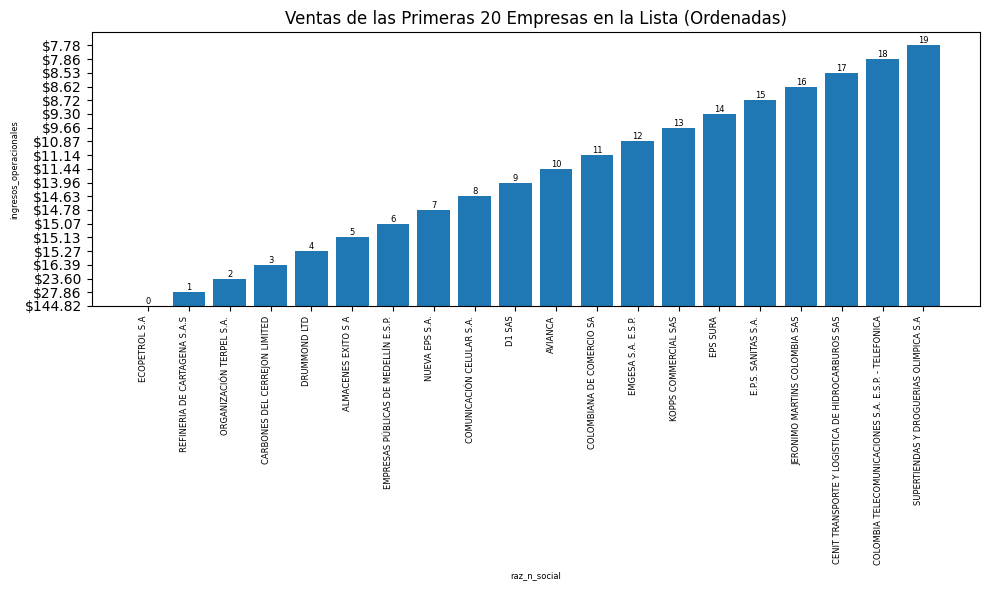

In [28]:

import matplotlib.pyplot as plt

# Cuenta la cantidad de Empresas por Cámara de Comercio
primeras_20_empresas = consulta_ventas.head(20)

# Crea el gráfico de barras
plt.figure(figsize=(10, 6))
# Convert index and values to lists explicitly
bars = plt.bar(primeras_20_empresas['raz_n_social'].tolist(), primeras_20_empresas['ingresos_operacionales'].tolist())

# Agrega etiquetas de valor a cada barra
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center', fontsize=6)

plt.xlabel('raz_n_social', fontsize=6)  # Etiqueta del eje x con tamaño de fuente 6
plt.ylabel('ingresos_operacionales', fontsize=6)  # Etiqueta del eje y con tamaño de fuente 6
plt.title('Ventas de las Primeras 20 Empresas en la Lista (Ordenadas)')
plt.xticks(rotation=90, ha='right', fontsize=6)  # Rota las etiquetas del eje x para mayor legibilidad
plt.tight_layout()  # Ajusta el diseño para evitar que las etiquetas se superpongan
plt.show()

# Paso 3: Hacer el peril de las Bases de Datos

In [29]:
prof = ProfileReport(df_Empresas)

In [30]:
prof

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [31]:
prof = ProfileReport(df_10000_Empresas)

In [32]:
prof

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [33]:
prof.to_file(output_file='10000_empresas.html')

/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:363: UserWarning: Try running command: 'pip install --upgrade Pillow' to avoid ValueError
  warnings.warn(


Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]